In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import kagglehub

plt.style.use("ggplot")
pd.set_option("display.max_columns", 200)
sns.set_theme()

In [4]:
# https://www.kaggle.com/datasets/mathchi/diabetes-data-set/data
file_path = "diabetes_data.csv"

df = kagglehub.dataset_load(
    kagglehub.KaggleDatasetAdapter.PANDAS,
    "prosperchuks/health-dataset",
    file_path
)

In [5]:
# Классы сбалансированы
df["Diabetes"].value_counts()

Diabetes
0.0    35346
1.0    35346
Name: count, dtype: int64

In [6]:
# Нет пропусков
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70692 entries, 0 to 70691
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Age                   70692 non-null  float64
 1   Sex                   70692 non-null  float64
 2   HighChol              70692 non-null  float64
 3   CholCheck             70692 non-null  float64
 4   BMI                   70692 non-null  float64
 5   Smoker                70692 non-null  float64
 6   HeartDiseaseorAttack  70692 non-null  float64
 7   PhysActivity          70692 non-null  float64
 8   Fruits                70692 non-null  float64
 9   Veggies               70692 non-null  float64
 10  HvyAlcoholConsump     70692 non-null  float64
 11  GenHlth               70692 non-null  float64
 12  MentHlth              70692 non-null  float64
 13  PhysHlth              70692 non-null  float64
 14  DiffWalk              70692 non-null  float64
 15  Stroke             

In [7]:
df.describe().T # описание статистик

,count,mean,std,min,25%,50%,75%,max
Age,70692.0,8.584055,2.852153,1.0,7.0,9.0,11.0,13.0
Sex,70692.0,0.456997,0.498151,0.0,0.0,0.0,1.0,1.0
HighChol,70692.0,0.525703,0.499342,0.0,0.0,1.0,1.0,1.0
CholCheck,70692.0,0.975259,0.155336,0.0,1.0,1.0,1.0,1.0
BMI,70692.0,29.856985,7.113954,12.0,25.0,29.0,33.0,98.0
Smoker,70692.0,0.475273,0.499392,0.0,0.0,0.0,1.0,1.0
HeartDiseaseorAttack,70692.0,0.147810,0.354914,0.0,0.0,0.0,0.0,1.0
PhysActivity,70692.0,0.703036,0.456924,0.0,0.0,1.0,1.0,1.0
Fruits,70692.0,0.611795,0.487345,0.0,0.0,1.0,1.0,1.0
Veggies,70692.0,0.788774,0.408181,0.0,1.0,1.0,1.0,1.0


/tmp/.private/blackwille/ipykernel_309011/883027456.py:39: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  f, ax = plt.subplots(2, 1)


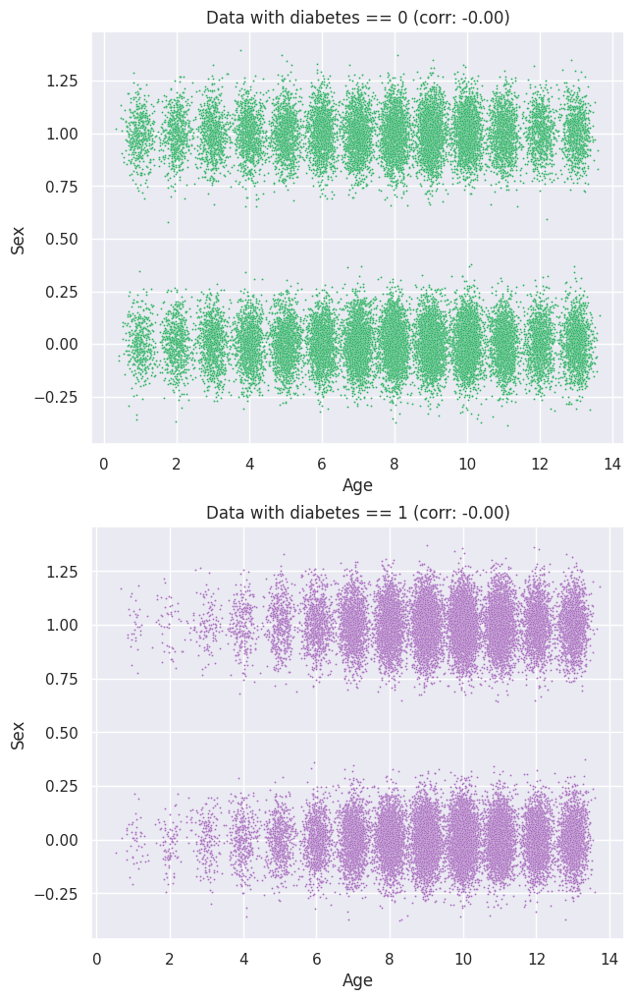

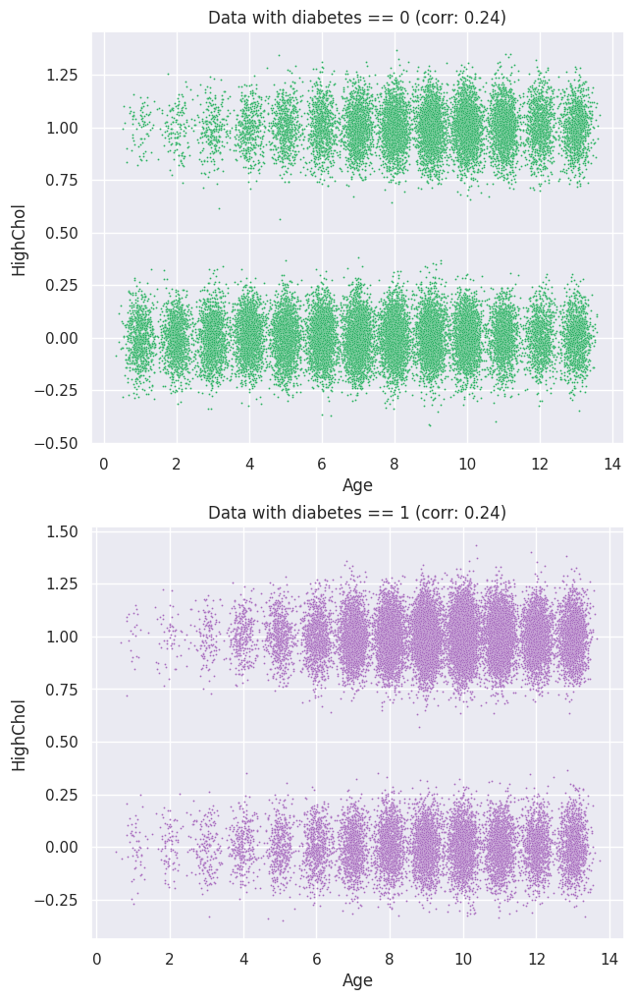

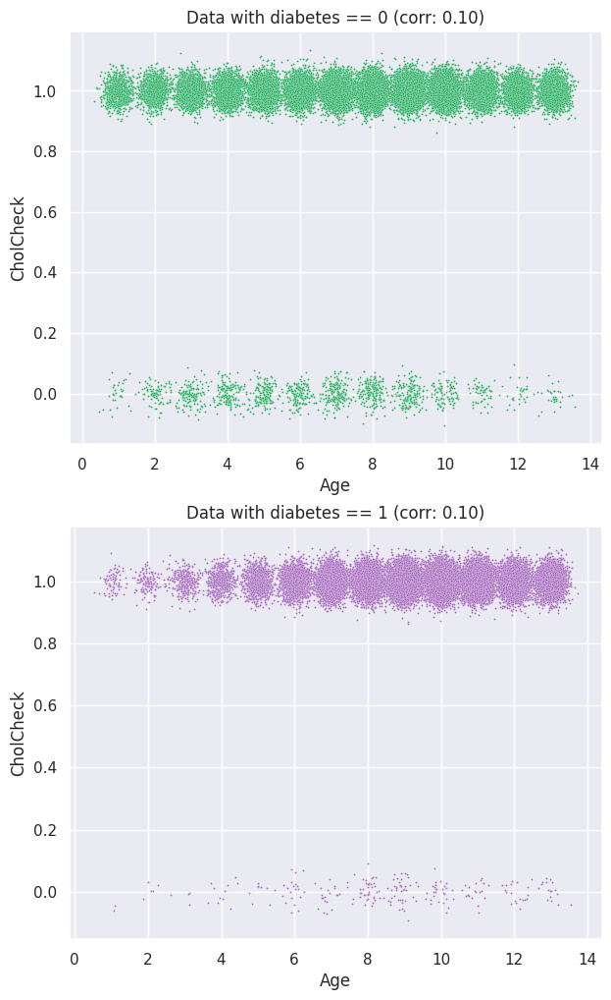

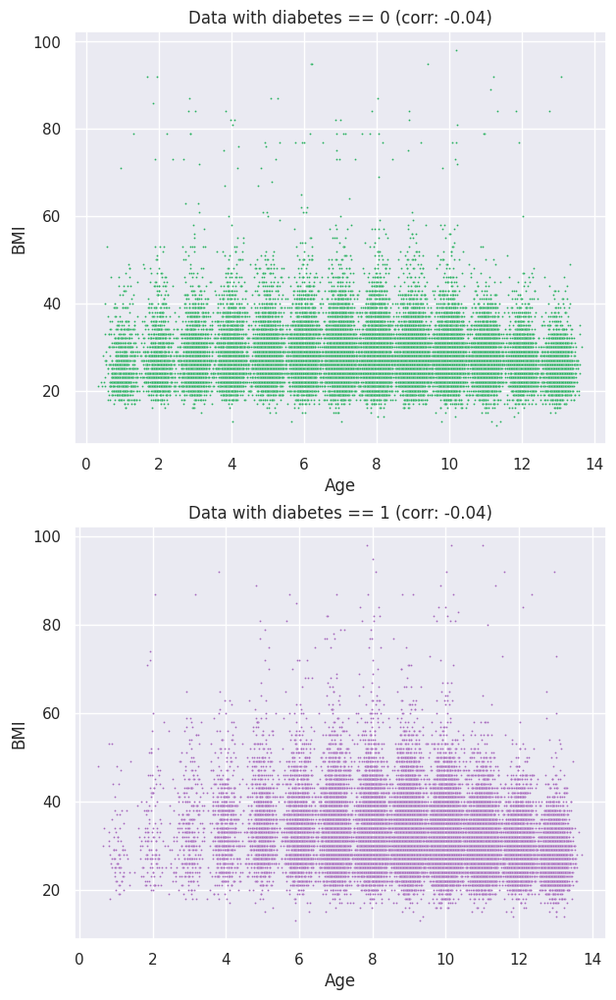

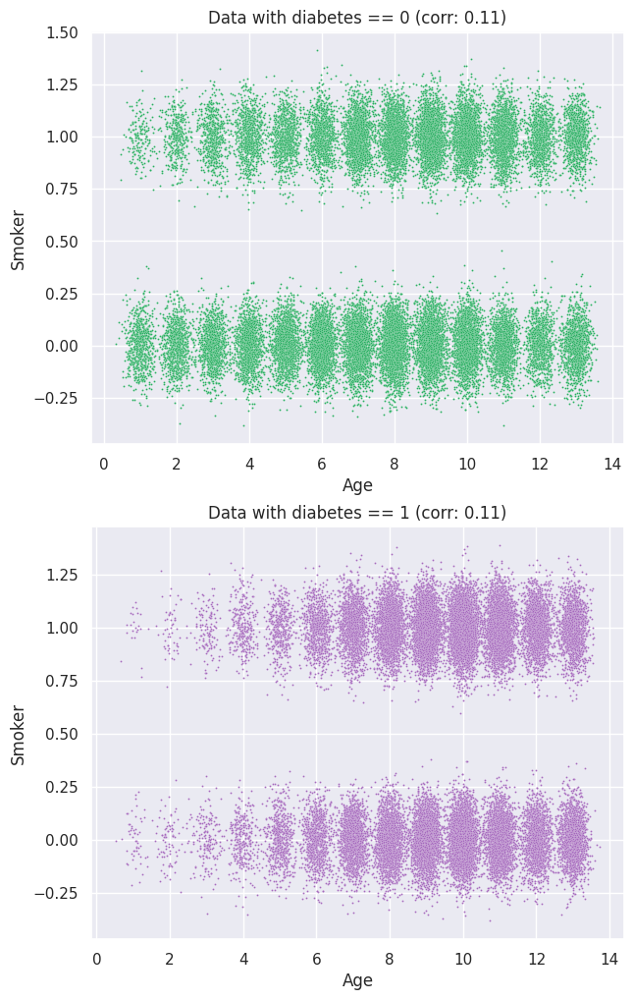

...

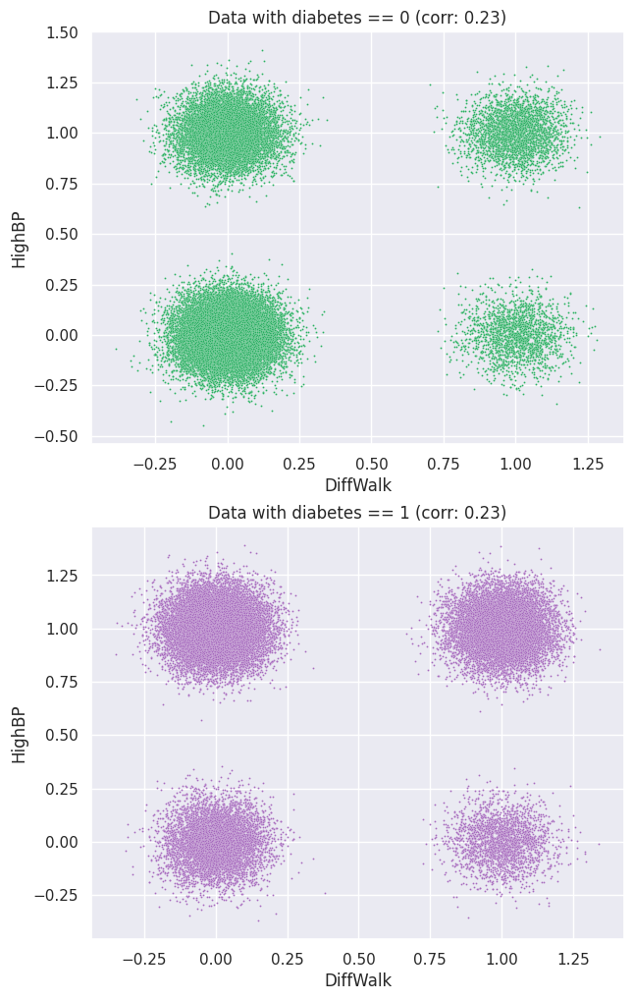

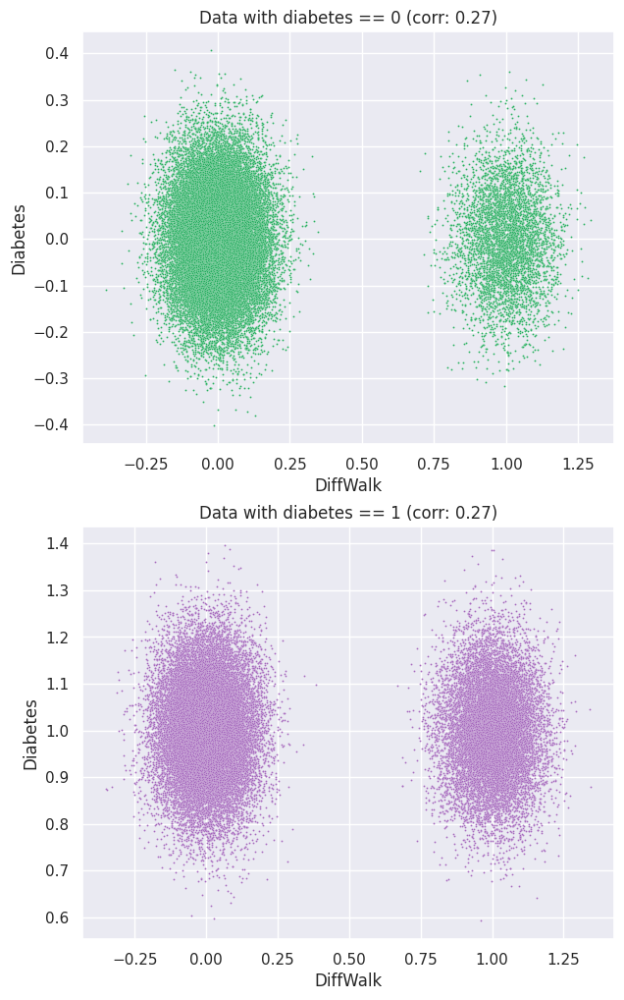

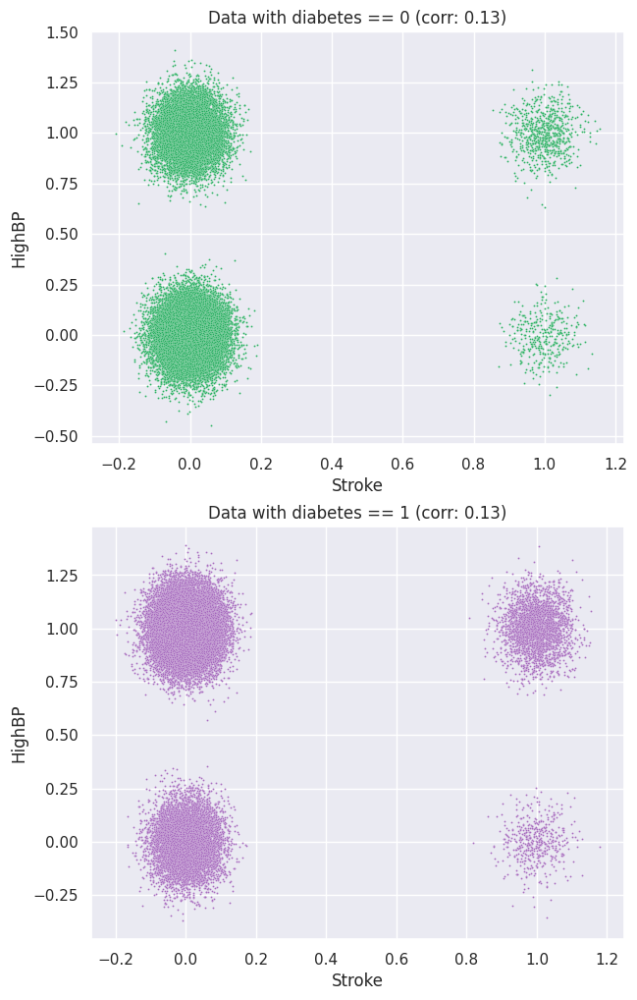

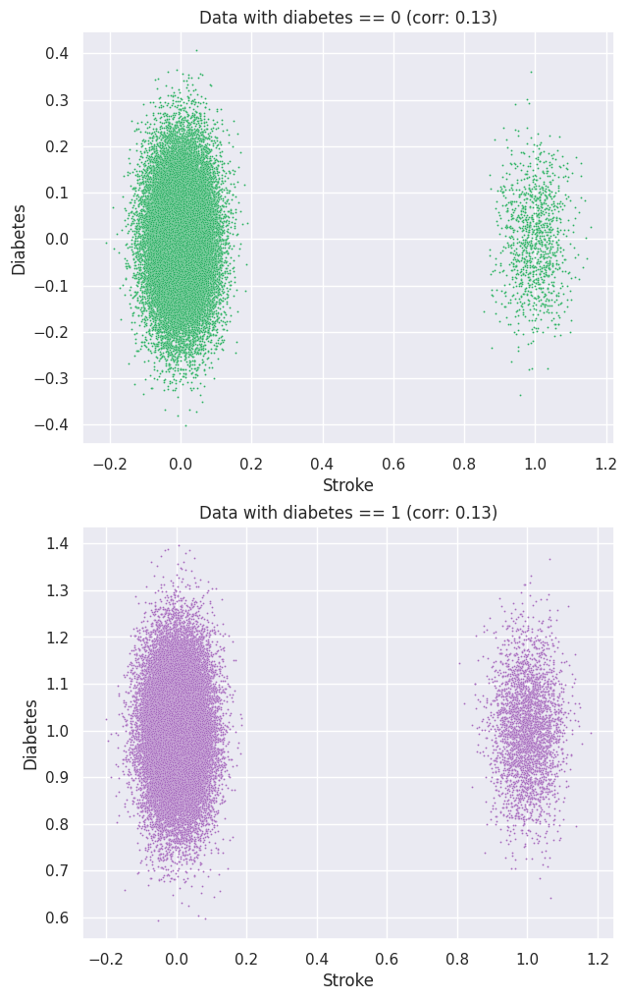

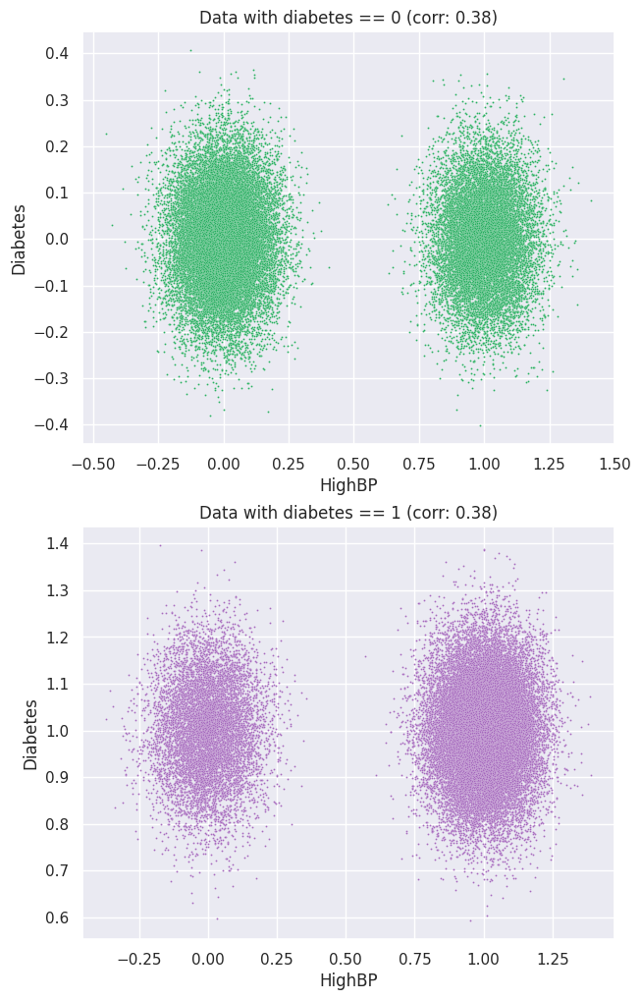

In [8]:
# Колонки с двумя возможными значениями ()
binary_columns = [
    "Sex", 
    "HighChol", 
    "CholCheck", 
    "Smoker", 
    "HeartDiseaseorAttack", 
    "PhysActivity", 
    "Fruits", 
    "Veggies", 
    "HvyAlcoholConsump", 
    "DiffWalk", 
    "Stroke", 
    "HighBP",
    "Diabetes",
]

# Колонки, которые не надо разбрасывать
not_touchable_columns = [
    "BMI",
    "MentHlth",
    "PhysHlth",
]

df_scattered = df.copy()
for column in df_scattered.columns:
    deviation_coef = 0.2 if column in binary_columns else 0.07
    if column not in not_touchable_columns:
        df_scattered[column] += np.random.normal(0, deviation_coef * df_scattered[column].std(), len(df_scattered))

# Расчет корреляций
corr = df.corr()

columns = df_scattered.columns
df_scattered_diabetes_0 = df_scattered.loc[df["Diabetes"] == 0]
df_scattered_diabetes_1 = df_scattered.loc[df["Diabetes"] == 1]
for i in range(len(columns) - 1):
    for j in range(i + 1, len(columns)):
        f, ax = plt.subplots(2, 1)
        f.set_size_inches(7, 12)
        ax[0].set_title(f"Data with diabetes == 0 (corr: {corr[columns[i]][columns[j]]:.2f})")
        ax[1].set_title(f"Data with diabetes == 1 (corr: {corr[columns[i]][columns[j]]:.2f})")
        sns.scatterplot(x=df_scattered_diabetes_0[columns[i]], y=df_scattered_diabetes_0[columns[j]], s=2, alpha=1, color="#27ae60", ax=ax[0]) 
        sns.scatterplot(x=df_scattered_diabetes_1[columns[i]], y=df_scattered_diabetes_1[columns[j]], s=2, alpha=1, color="#a569bd", ax=ax[1])

<Axes: >

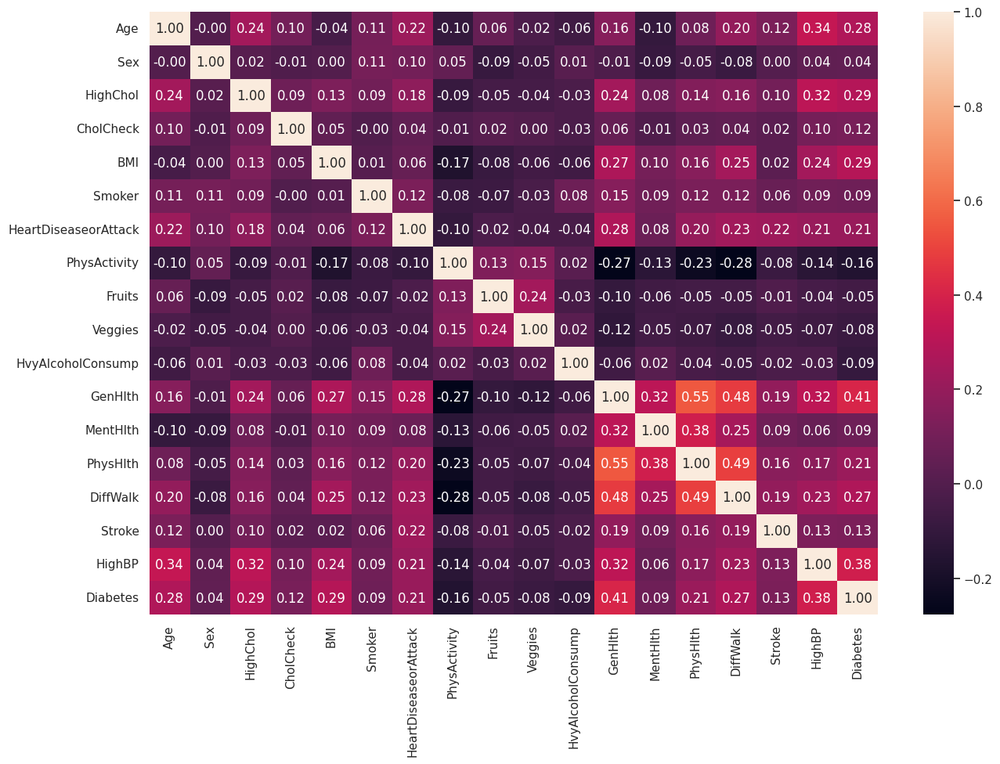

In [9]:
plt.figure(figsize=(15, 10))
sns.heatmap(corr, annot=True, fmt=".2f")